### CAV LIKENESS

In [25]:
import numpy as np
import os
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import re
from keras.api.saving import load_model

In [26]:
def get_manual_cavs_and_names(manual_concept_probe_path, layer_i, conv_spatial_shapes):
    manual_cavs = []  
    manual_concept_names = []   
    
    for filename in sorted(os.listdir(manual_concept_probe_path)):
        if filename.endswith(f"_layer_{layer_i}_concept_probe.keras"):
            concept_name_match = re.match(
            r"(.+)_layer_{}_concept_probe\.keras".format(layer_i), filename
            )
            if concept_name_match:
                concept_name = concept_name_match.group(1)
                manual_concept_names.append(concept_name)
            else:
                raise ValueError("No concept name match")

            probe: Sequential = load_model(f"{manual_concept_probe_path}{filename}")  # type: ignore
            weights, _ = probe.layers[0].get_weights()
            if layer_i in conv_spatial_shapes:
                H, W, C = conv_spatial_shapes[layer_i]
                cav = weights[:, 0].reshape(H, W, C).mean(axis=(0, 1))  # GAP
            else:
                cav = weights[:, 0]
            manual_cavs.append(cav)

    manual_cavs = np.array(manual_cavs)

    return manual_cavs, manual_concept_names

In [27]:

def show_cav_cosine_similarity_matrices(
    manual_concept_probe_path,
    conv_spatial_shapes,
    environment_name,
    environment_display_name,
):
    for layer_i in [0,1,3,4,5]:
        manual_cavs, manual_concept_names = get_manual_cavs_and_names(manual_concept_probe_path=manual_concept_probe_path, layer_i=layer_i, conv_spatial_shapes=conv_spatial_shapes)
        cavs_n = len(manual_cavs)

        k_means_cavs = np.load(f"../../rl_ace_data/concept_examples/k_means/{environment_name}/model_of_interest_target_class_balanced_observations/layer_{layer_i}/k_{cavs_n}_cluster_centroids.npy")

        fc_means_cavs = np.load(f"../../rl_ace_data/concept_examples/fuzzy_c_means/{environment_name}/model_of_interest_target_class_balanced_observations/layer_{layer_i}/c_{cavs_n}_cluster_centroids.npy")


        results = {}

        results["manual_vs_manual"] = cosine_similarity(manual_cavs, manual_cavs)
        results["kmeans_vs_kmeans"] = cosine_similarity(k_means_cavs, k_means_cavs)
        results["fcmeans_vs_fcmeans"] = cosine_similarity(fc_means_cavs, fc_means_cavs)

        results["manual_vs_kmeans"] = cosine_similarity(manual_cavs, k_means_cavs)
        results["manual_vs_fcmeans"] = cosine_similarity(manual_cavs, fc_means_cavs)
        results["kmeans_vs_fcmeans"] = cosine_similarity(k_means_cavs, fc_means_cavs)

        if layer_i == 1:
            ice_path = f"../../rl_ice_data/ncavs/{environment_name}/model_of_interest_target_class_balanced_observations/layer_1/c_{cavs_n}_ncavs.npy"
            ice_cavs = np.load(ice_path)
            results["ice_vs_ice"] = cosine_similarity(ice_cavs, ice_cavs)

            results["manual_vs_ice"] = cosine_similarity(manual_cavs, ice_cavs)
            results["kmeans_vs_ice"] = cosine_similarity(k_means_cavs, ice_cavs)
            results["fcmeans_vs_ice"] = cosine_similarity(fc_means_cavs, ice_cavs)

        for name, matrix in results.items():
            df = pd.DataFrame(matrix)

            # Check if manual CAVs are involved to apply concept names to the appropriate axis
            row_labels = None
            col_labels = None

            if name.startswith("manual_vs_"):
                row_labels = manual_concept_names
            if name.endswith("_vs_manual"):
                col_labels = manual_concept_names
            if name == "manual_vs_fcmeans" or name == "manual_vs_kmeans" or name == "manual_vs_ice":
                row_labels = manual_concept_names
            if name == "fcmeans_vs_manual" or name == "kmeans_vs_manual" or name == "ice_vs_manual":
                col_labels = manual_concept_names
            if name == "manual_vs_manual":
                row_labels = manual_concept_names
                col_labels = manual_concept_names

            df.index = row_labels if row_labels else df.index  # type: ignore
            df.columns = col_labels if col_labels else df.columns

            num_labels = len(df)
            scale = 1

            plt.figure(figsize=(num_labels * scale, num_labels * scale * 0.8))
            sns.heatmap(
                df,
                annot=True,
                fmt=".2f",
                cmap="viridis",
                cbar=True,
                vmin=-1,
                vmax=1
            )
            plt.title(f"Cosine Similarity: {name} (Layer {layer_i}), {environment_display_name}")
            plt.xlabel(name.split("_vs_")[1])
            plt.ylabel(name.split("_vs_")[0])
            plt.xticks(rotation=45, ha='right')
            plt.yticks(rotation=0)
            plt.tight_layout()
            plt.show()


In [98]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy.optimize import linear_sum_assignment
import numpy as np

def match_cavs(cav_set_a, cav_set_b):
    similarity_matrix = cosine_similarity(cav_set_a, cav_set_b)
    cost_matrix = -similarity_matrix

    # Pad to square if needed
    a_len, b_len = similarity_matrix.shape
    if a_len > b_len:
        pad_width = a_len - b_len
        cost_matrix = np.pad(cost_matrix, ((0, 0), (0, pad_width)), constant_values=2)
    elif b_len > a_len:
        pad_height = b_len - a_len
        cost_matrix = np.pad(cost_matrix, ((0, pad_height), (0, 0)), constant_values=2)

    row_ind, col_ind = linear_sum_assignment(cost_matrix)
    valid_matches = [(i, j) for i, j in zip(row_ind, col_ind) if i < a_len and j < b_len]
    total_similarity = sum(similarity_matrix[i, j] for i, j in valid_matches)
    return valid_matches, total_similarity

import pandas as pd

def match_cavs_to_manual_cavs(
    manual_concept_probe_path,
    conv_spatial_shapes,
    environment_name,
):
    all_matches = []
    summary_stats = []

    for layer_i in [0, 1, 3, 4, 5]:
        manual_cavs, _ = get_manual_cavs_and_names(
            manual_concept_probe_path=manual_concept_probe_path,
            layer_i=layer_i,
            conv_spatial_shapes=conv_spatial_shapes,
        )

        

        for cavs_n in range(2, 51):
            method_cavs_dict = {}

            try:
                method_cavs_dict["k_means"] = np.load(
                    f"../../rl_ace_data/concept_examples/k_means/{environment_name}/model_of_interest_target_class_balanced_observations/layer_{layer_i}/k_{cavs_n}_cluster_centroids.npy"
                )
            except FileNotFoundError:
                continue  # Skip if file doesn't exist

            try:
                method_cavs_dict["fc_means"] = np.load(
                    f"../../rl_ace_data/concept_examples/fuzzy_c_means/{environment_name}/model_of_interest_target_class_balanced_observations/layer_{layer_i}/c_{cavs_n}_cluster_centroids.npy"
                )
            except FileNotFoundError:
                continue

            if layer_i == 1:
                try:
                    method_cavs_dict["ice"] = np.load(
                        f"../../rl_ice_data/ncavs/{environment_name}/model_of_interest_target_class_balanced_observations/layer_1/c_{cavs_n}_ncavs.npy"
                    )
                except FileNotFoundError:
                    pass

            for method_name, cav_set in method_cavs_dict.items():
                similarity_matrix = cosine_similarity(manual_cavs, cav_set)
                matches, total_similarity = match_cavs(manual_cavs, cav_set)

                for i, j in matches:
                    all_matches.append({
                        "layer": layer_i,
                        "method": method_name,
                        "cavs_n": cavs_n,
                        "manual_index": i,
                        "matched_index": j,
                        "cosine_similarity": similarity_matrix[i, j],
                    })

                summary_stats.append({
                    "layer": layer_i,
                    "method": method_name,
                    "cavs_n": cavs_n,
                    "total_cosine_similarity": total_similarity,
                    "mean_cosine_similarity": total_similarity / len(matches),
                    "max_cosine_similarity": max(similarity_matrix[i, j] for i, j in matches), # type: ignore
                })

    df_matches = pd.DataFrame(all_matches)
    df_summary = pd.DataFrame(summary_stats)
    return df_matches, df_summary

#### GEM COLLECTOR

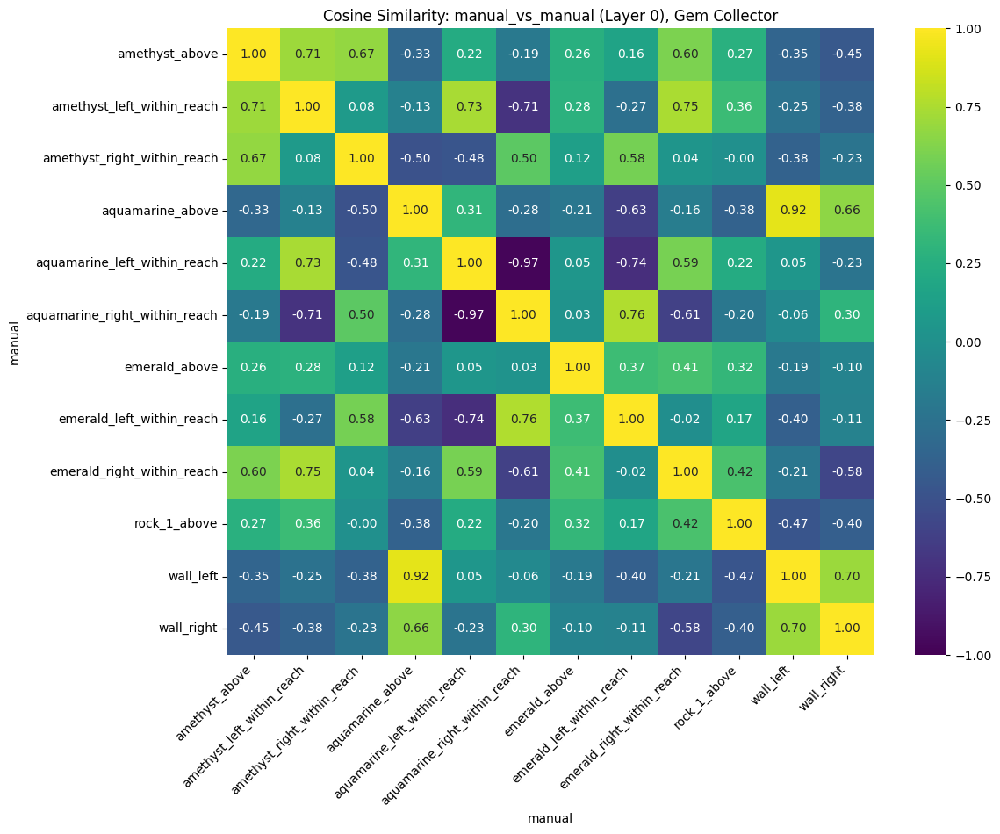

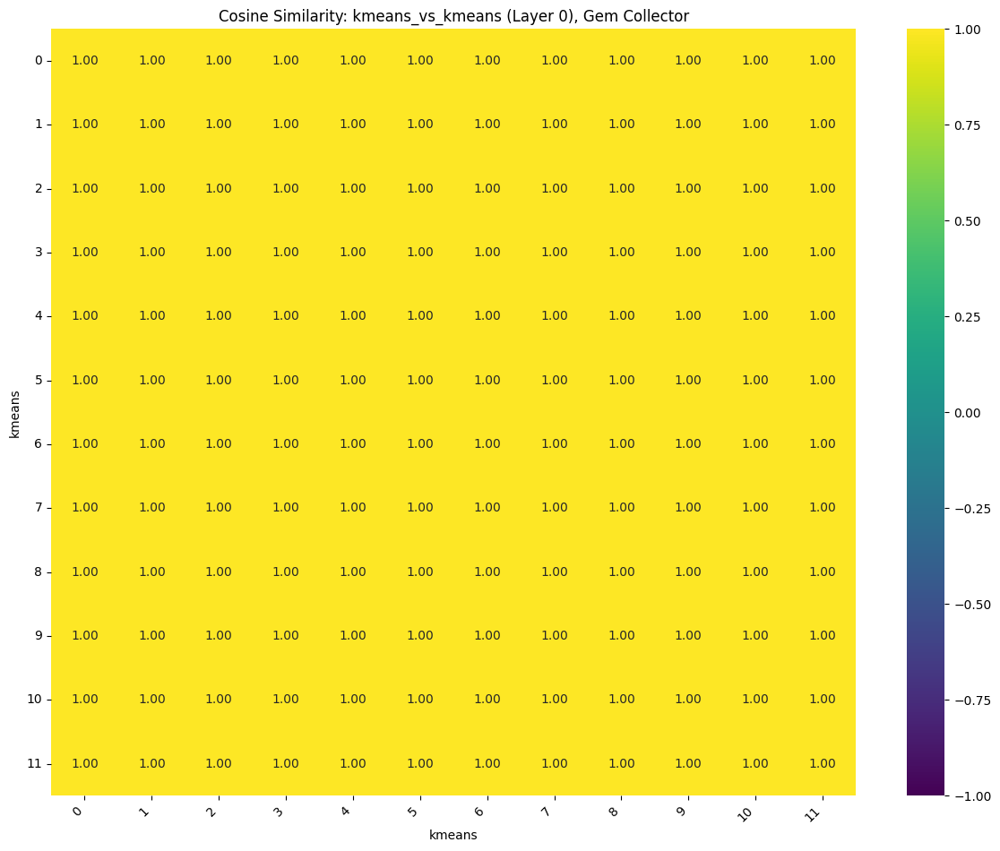

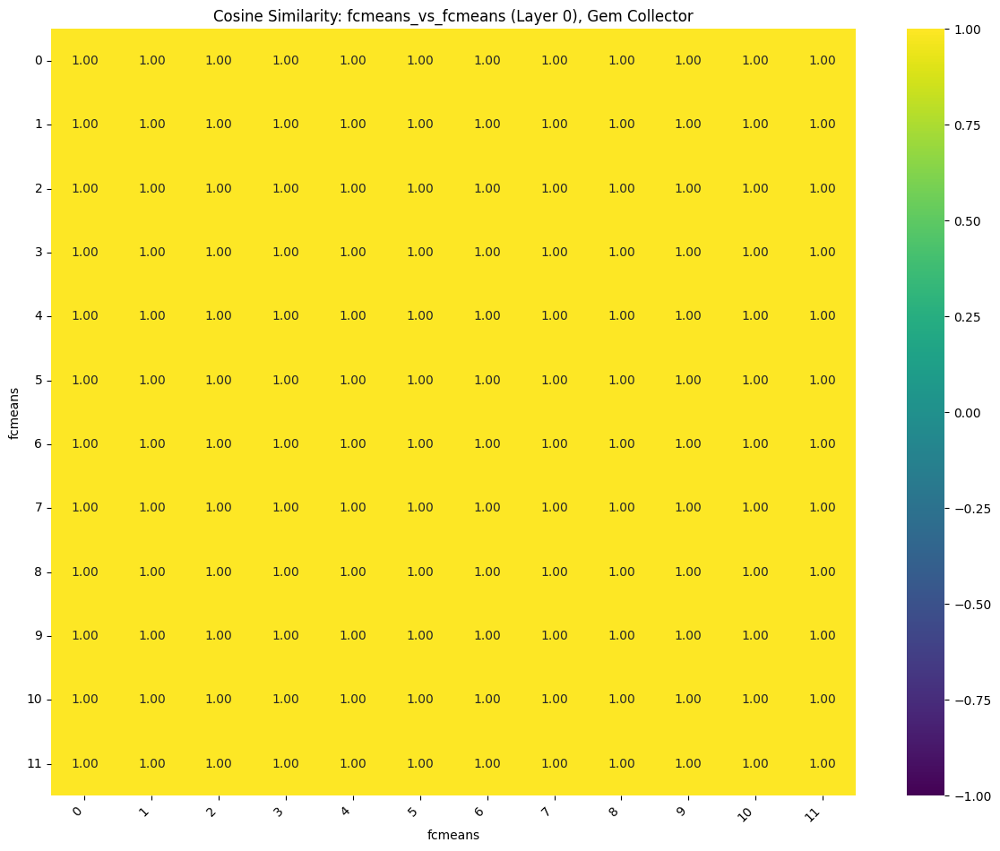

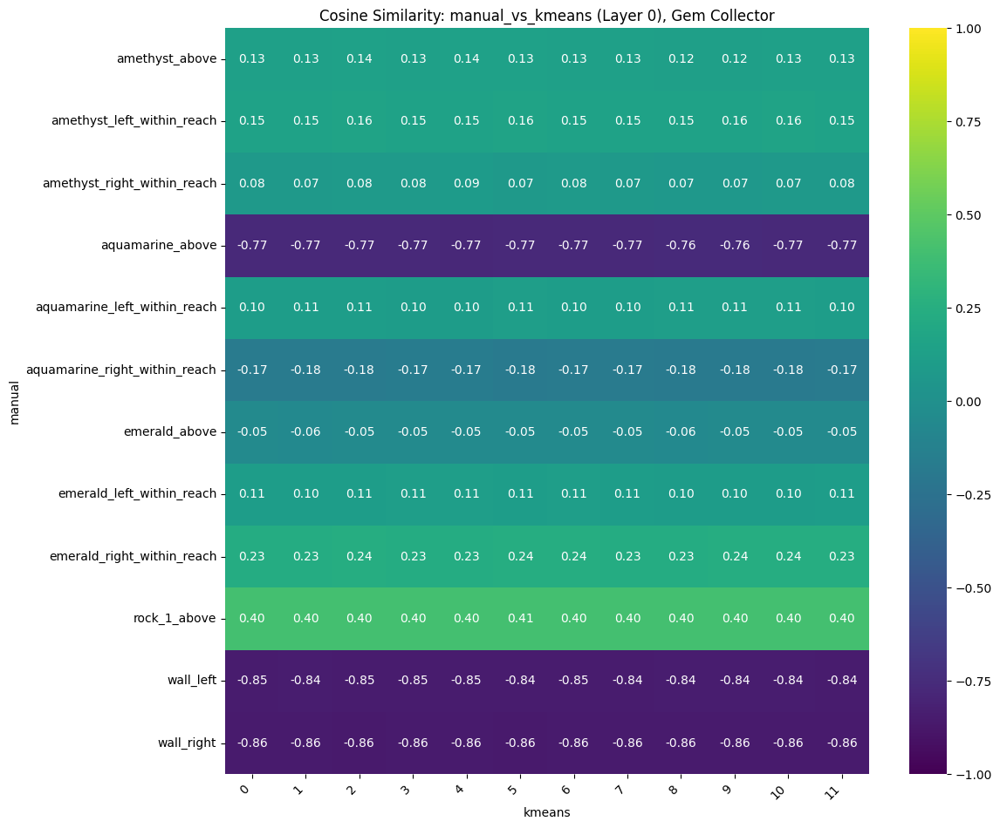

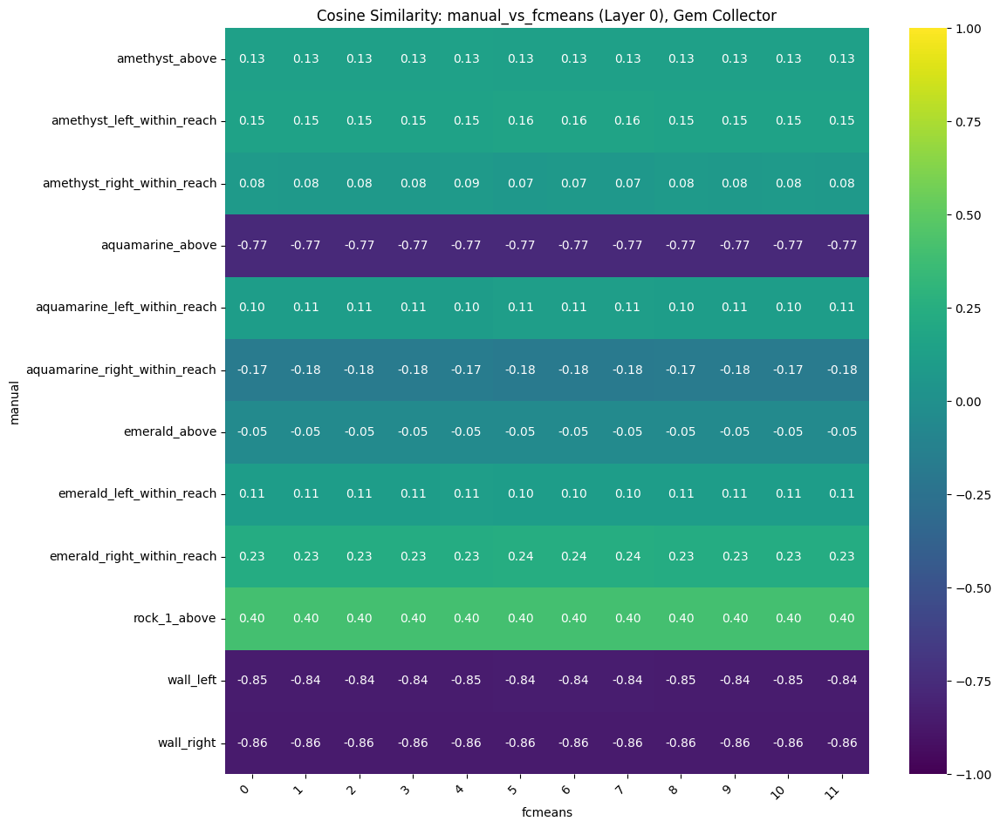

...

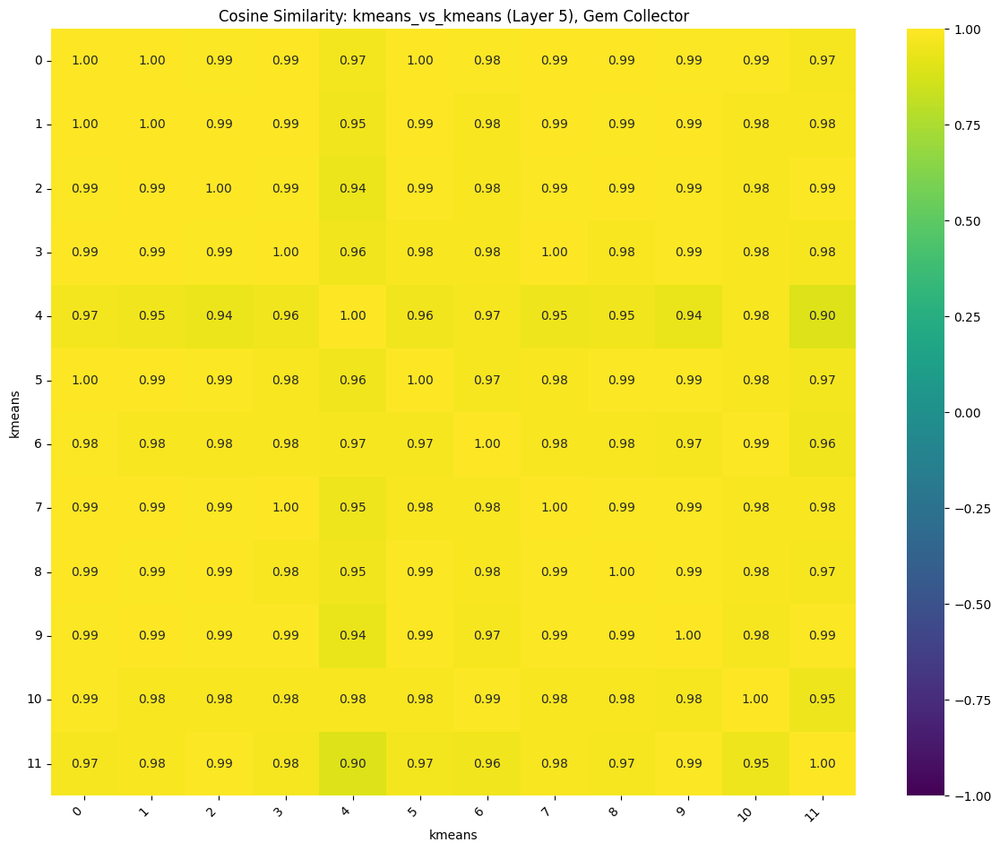

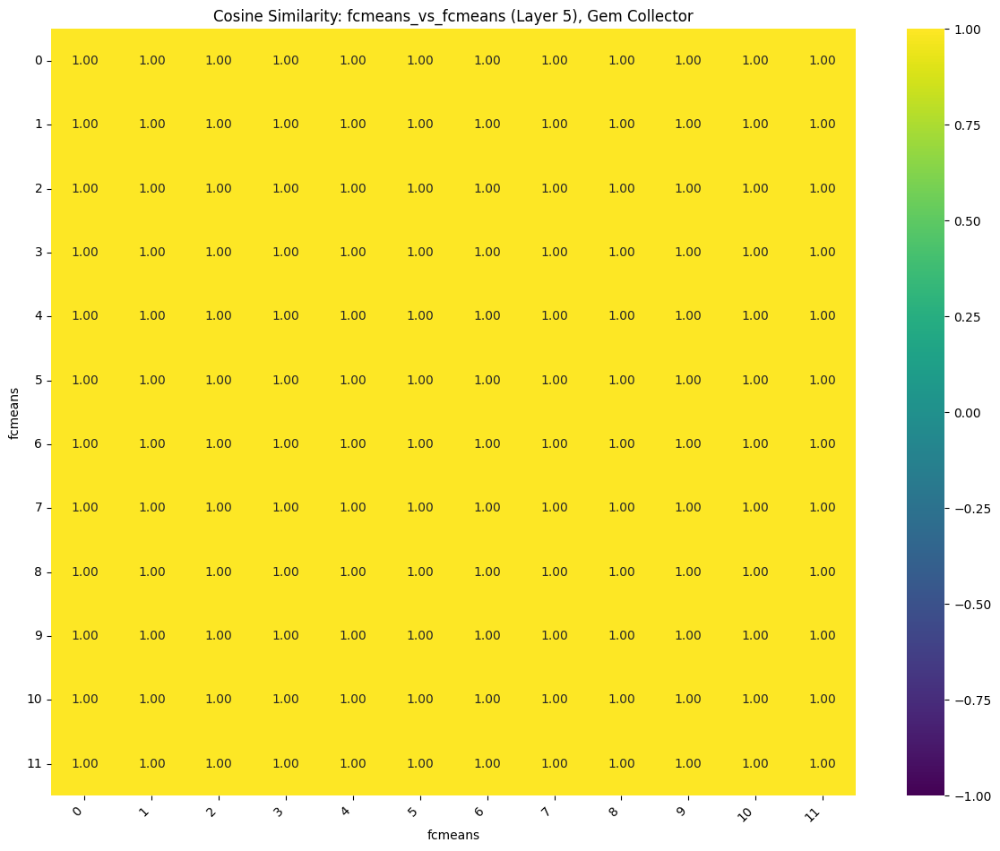

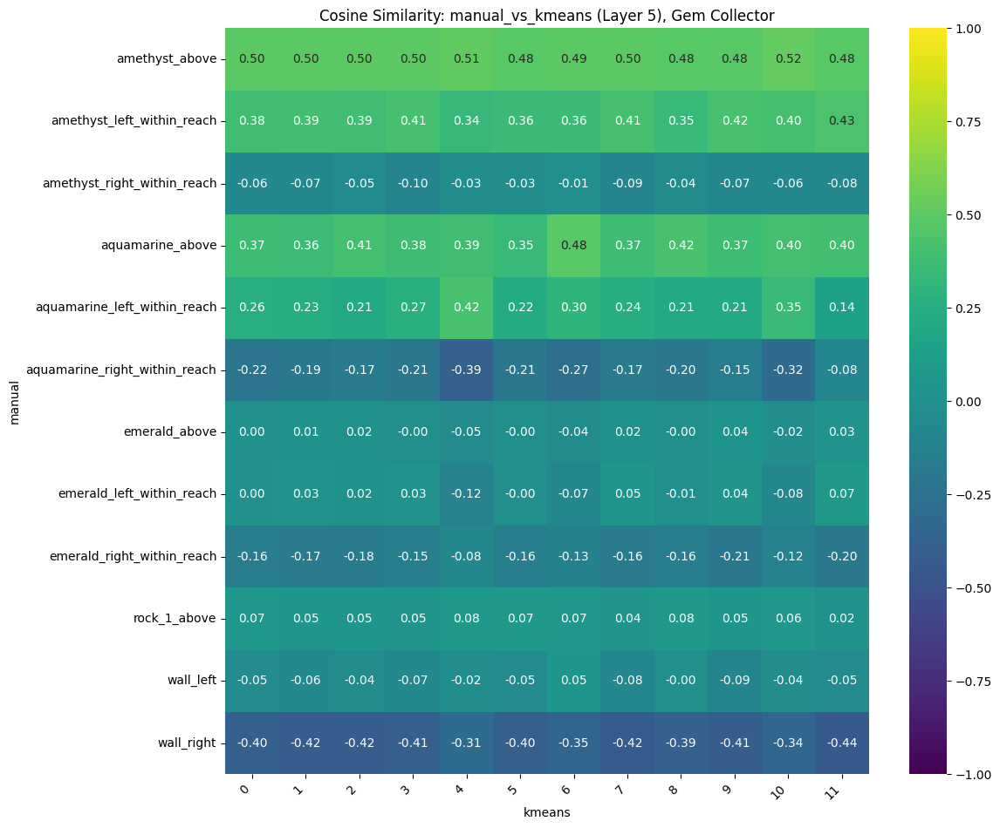

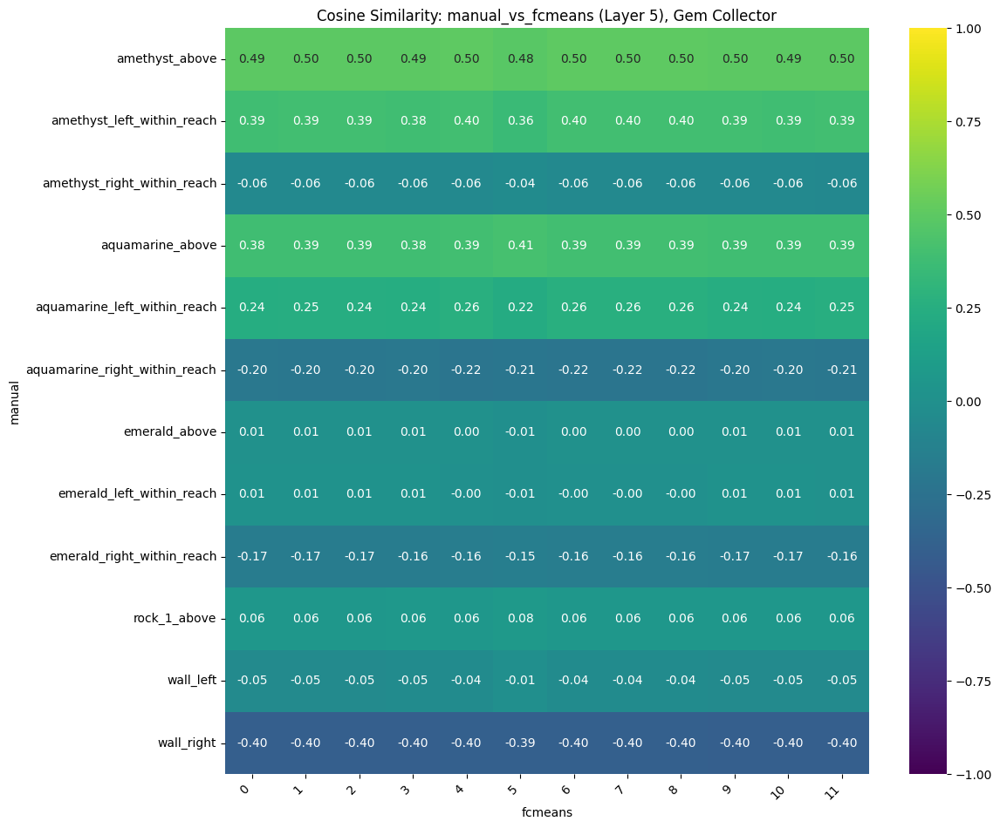

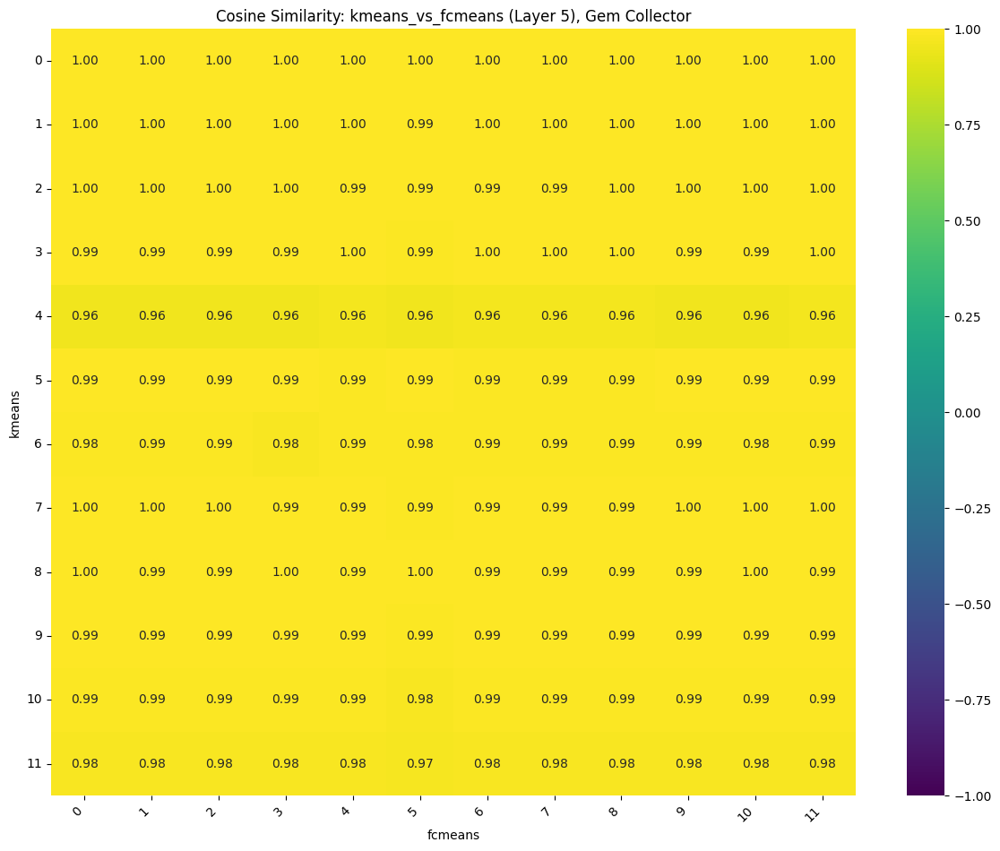

In [29]:


manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/gem_collector/completeness_testing/denim-sweep-56/"
                )

conv_spatial_shapes = {
    0: (20, 20, 32),
    1: (20, 20, 64)
}

show_cav_cosine_similarity_matrices(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="gem_collector", environment_display_name="Gem Collector")

#### Gold Run

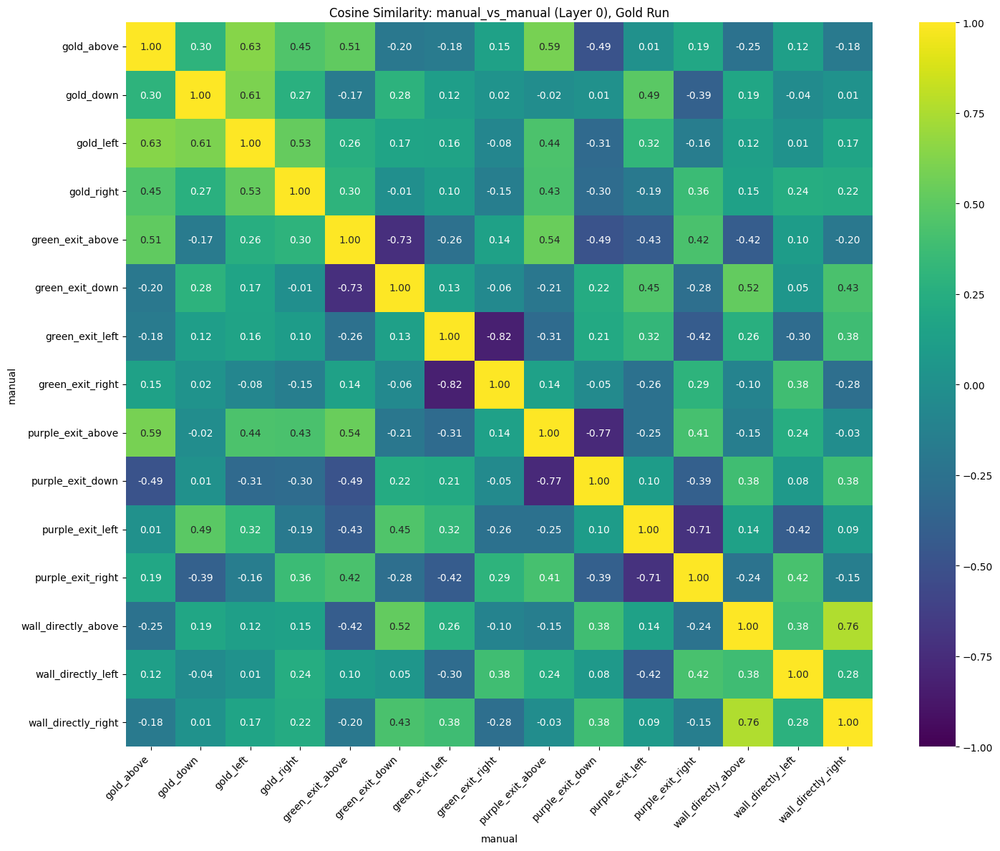

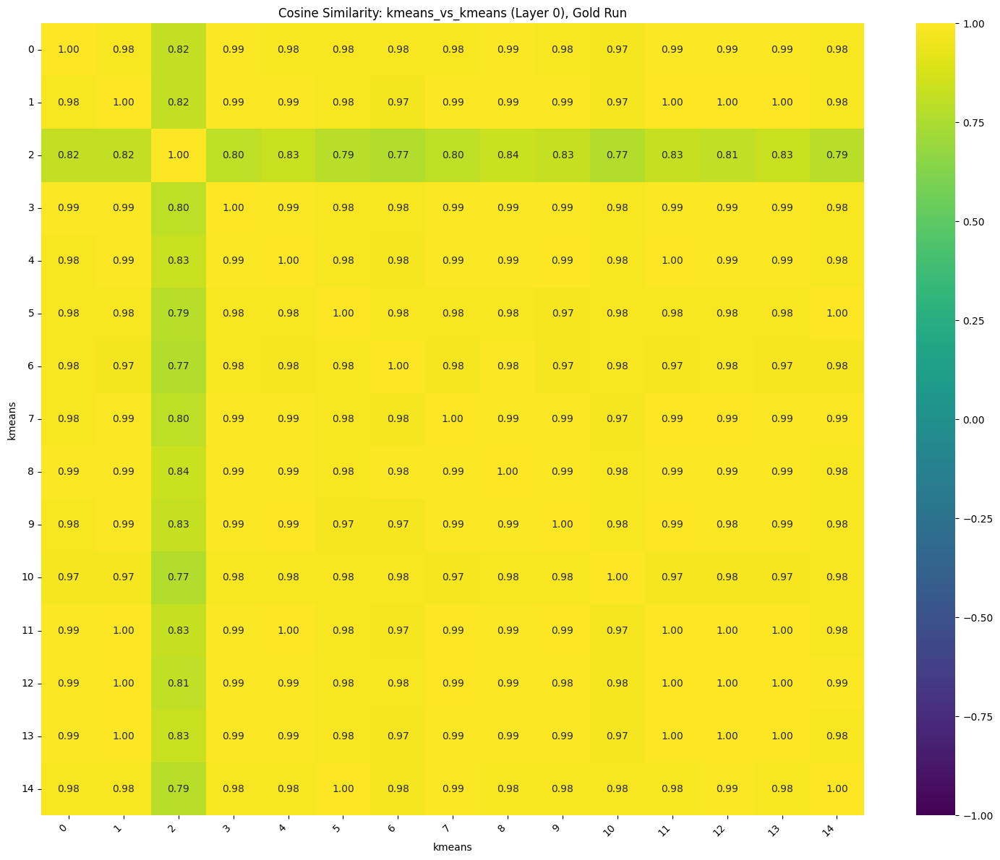

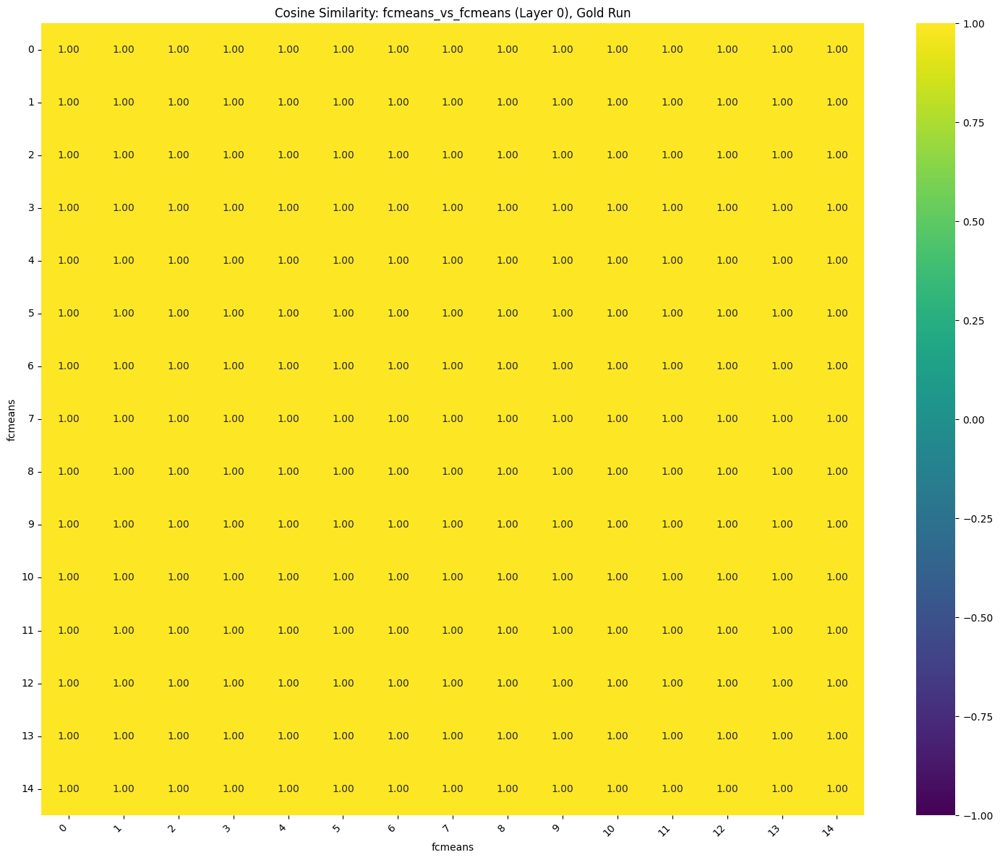

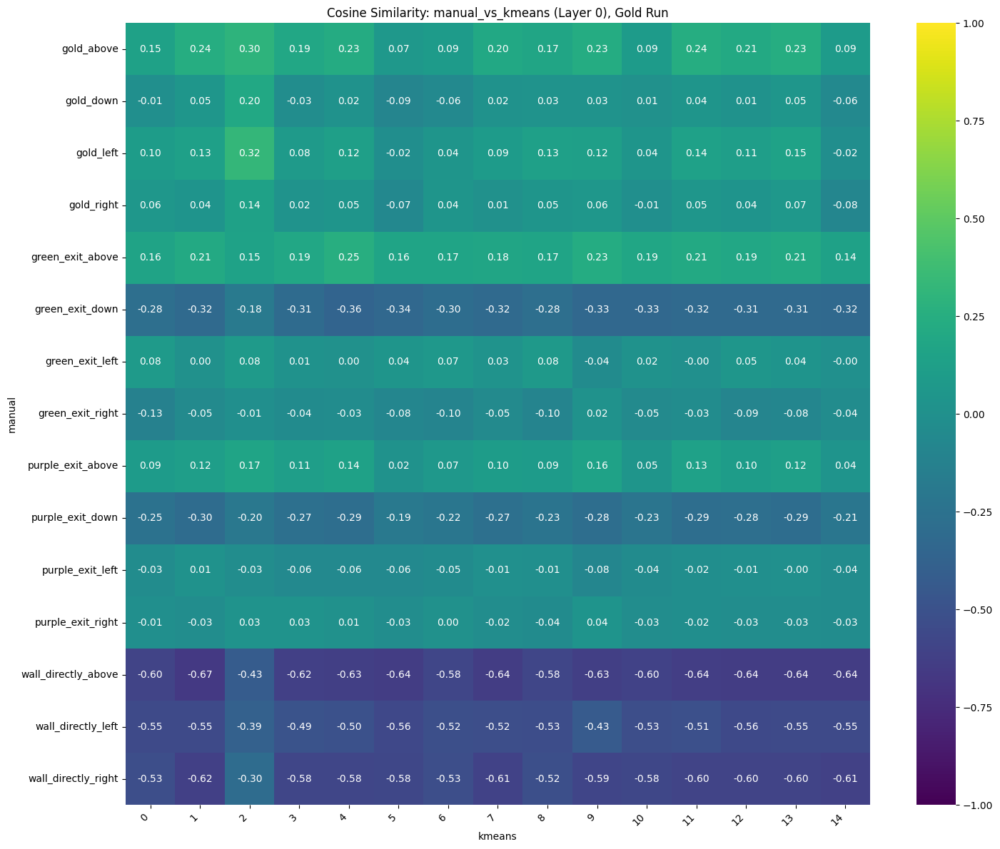

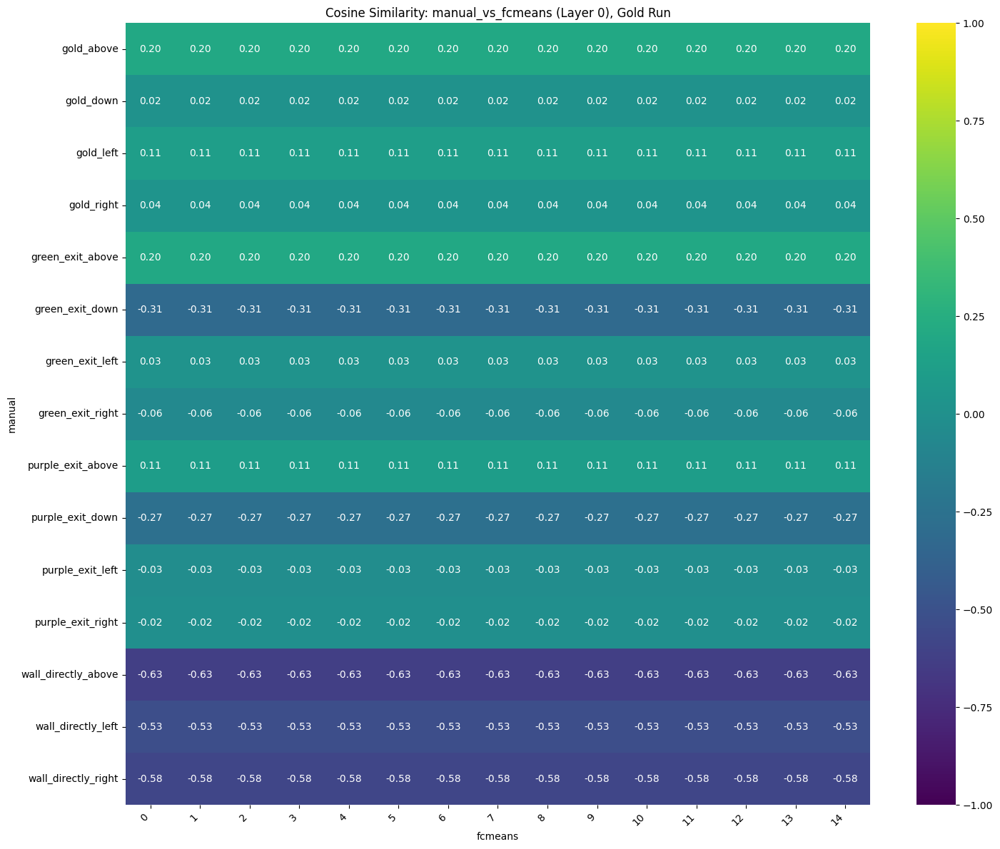

...

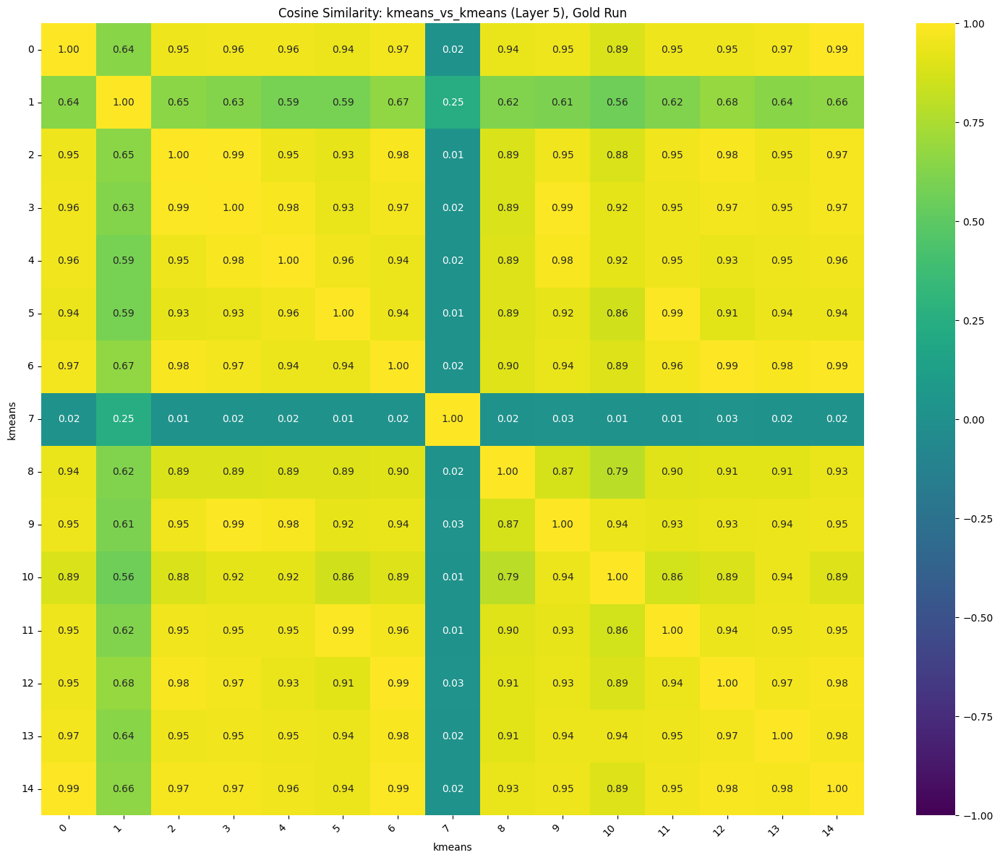

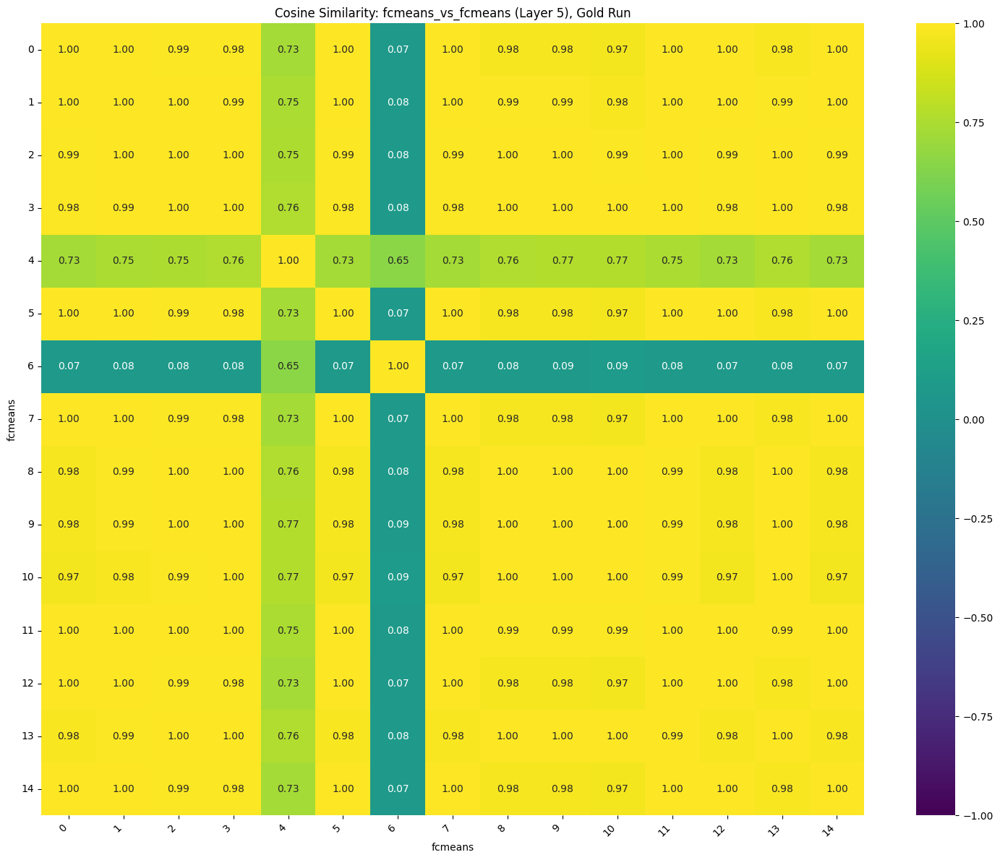

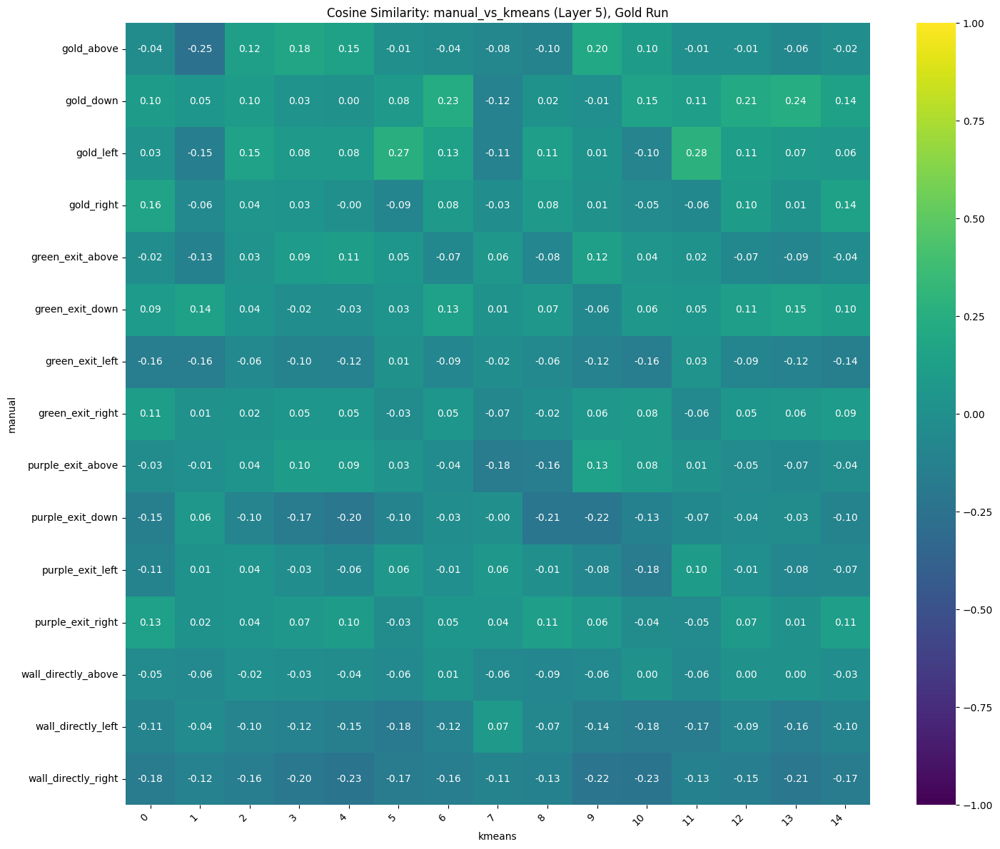

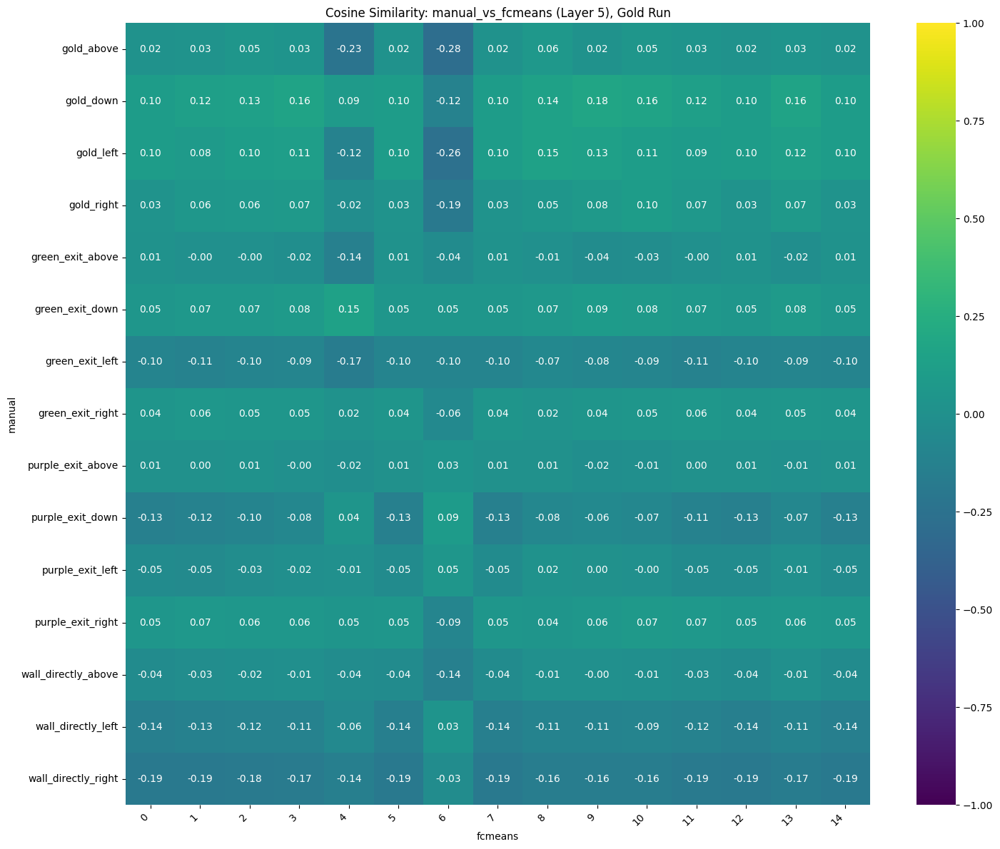

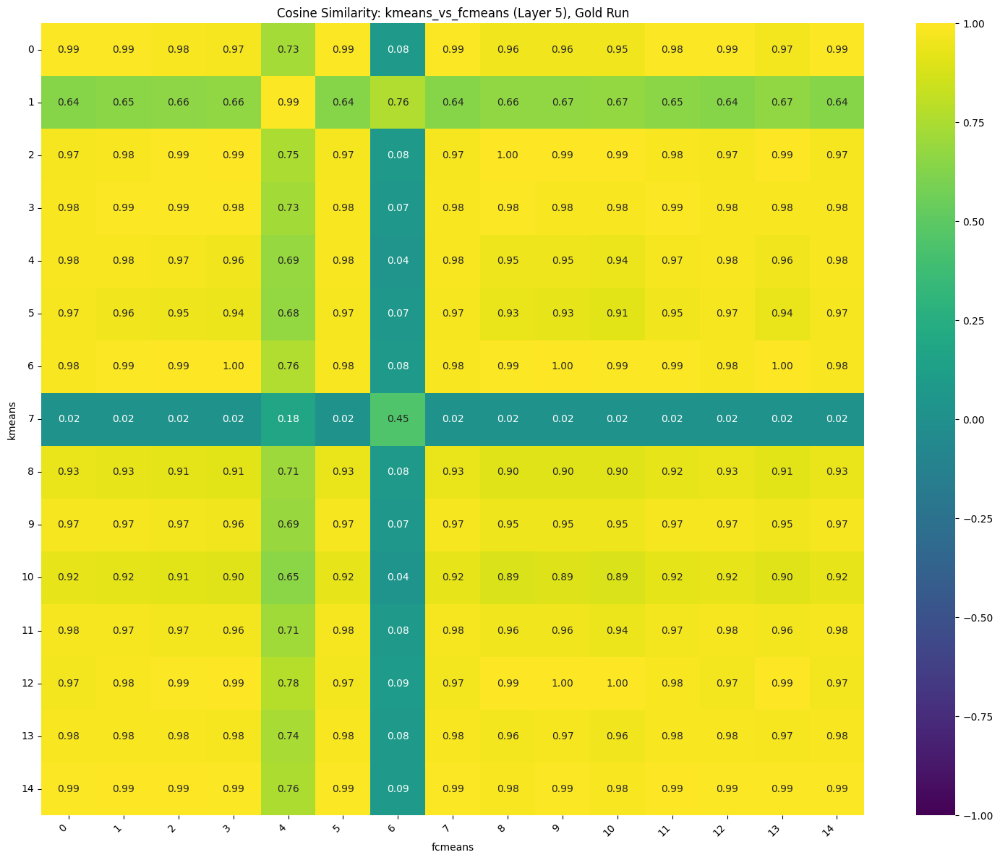

In [30]:
manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/gold_run_mini/completeness_testing/firm-mountain-13/"
                )

conv_spatial_shapes = {
    0: (11, 11, 32),
    1: (11, 11, 64)
}

show_cav_cosine_similarity_matrices(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="gold_run_mini", environment_display_name="Gold Run")

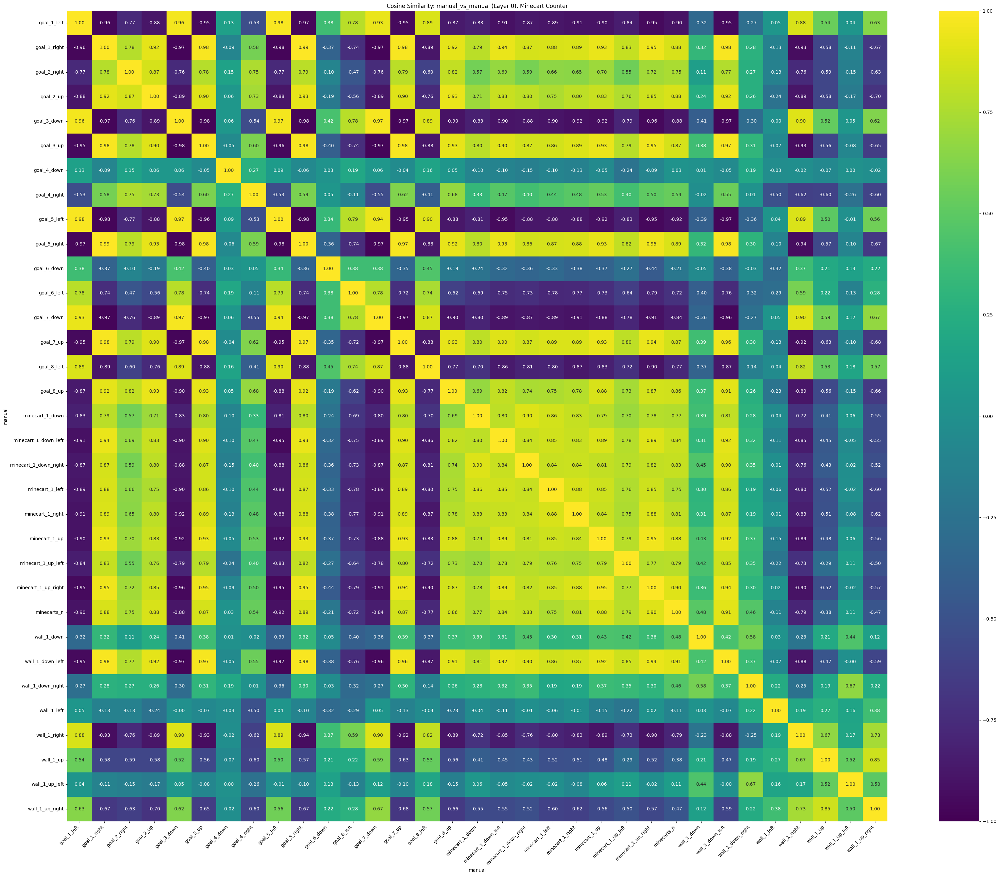

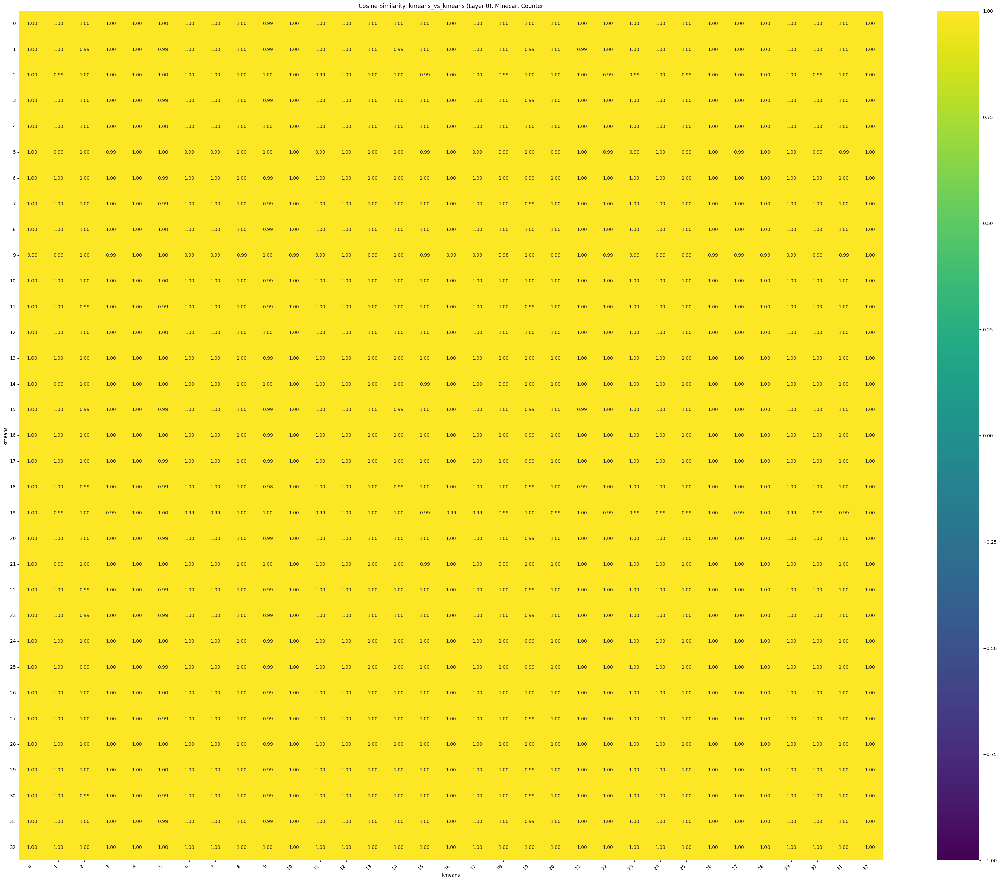

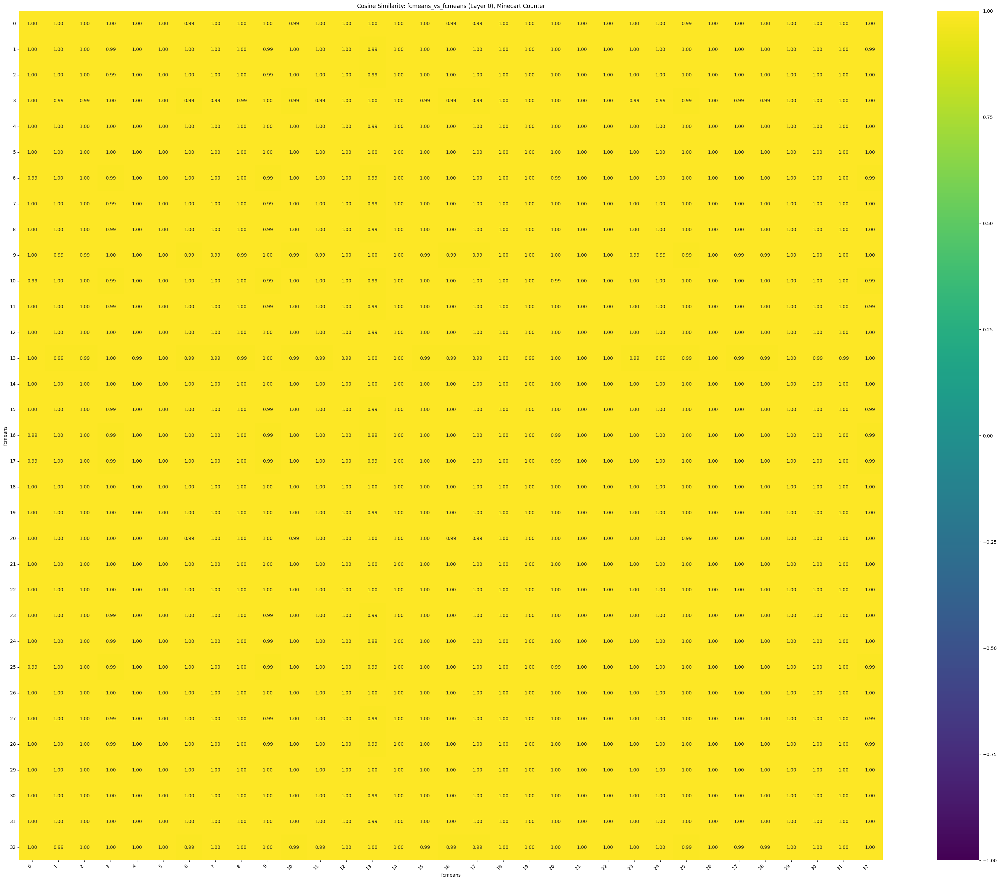

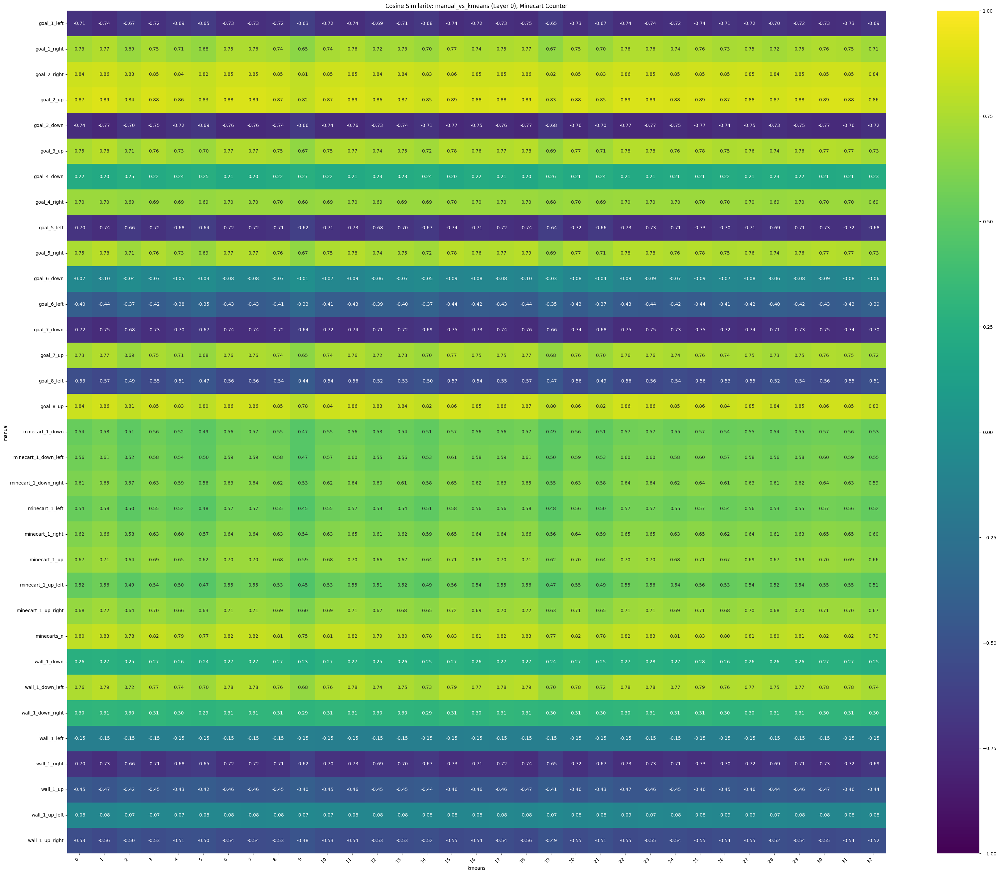

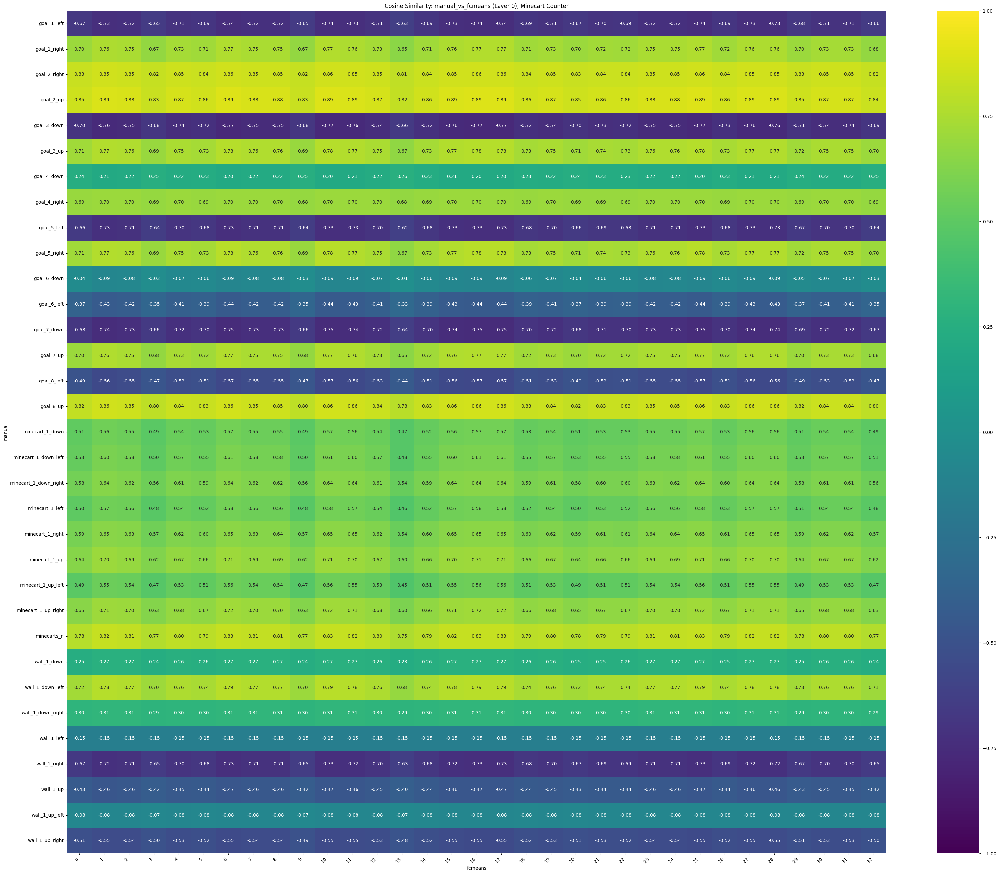

...

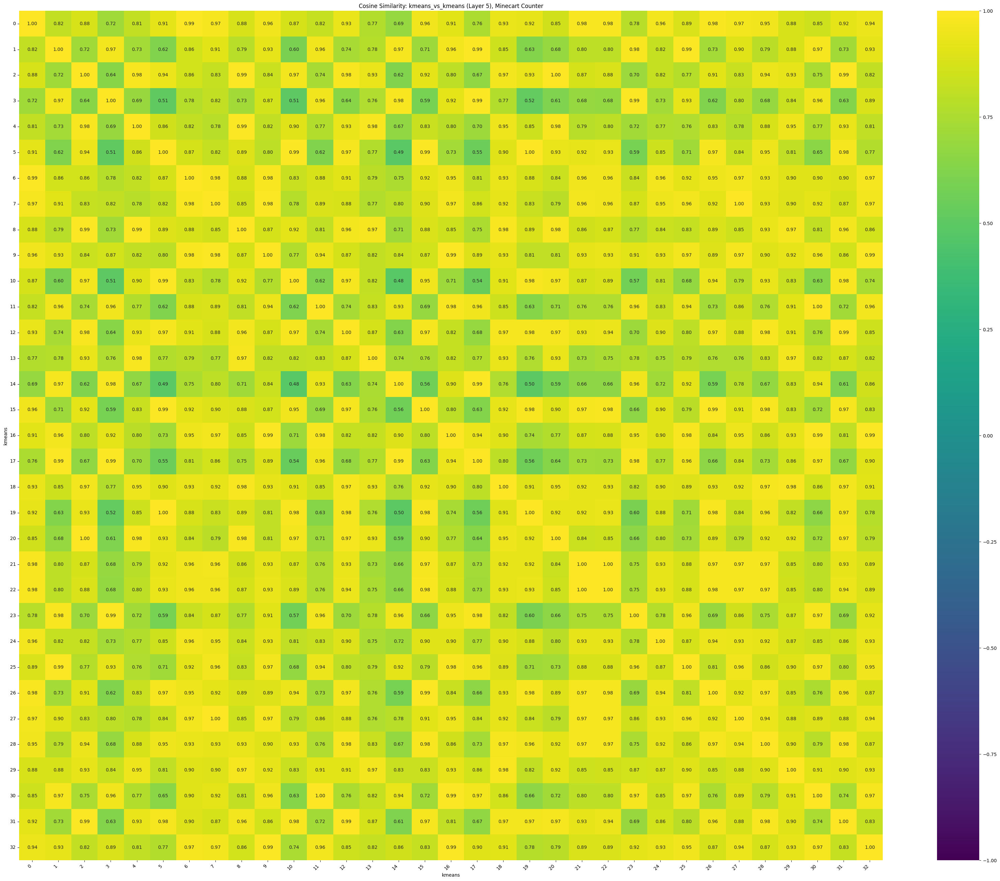

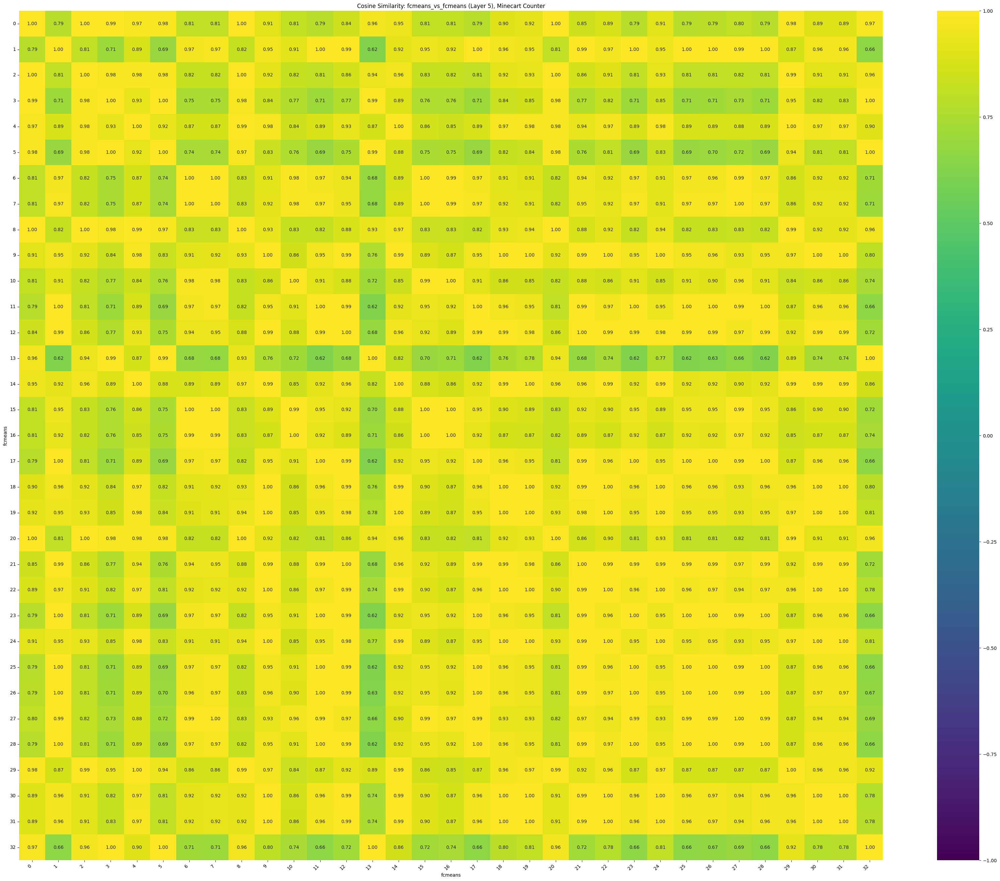

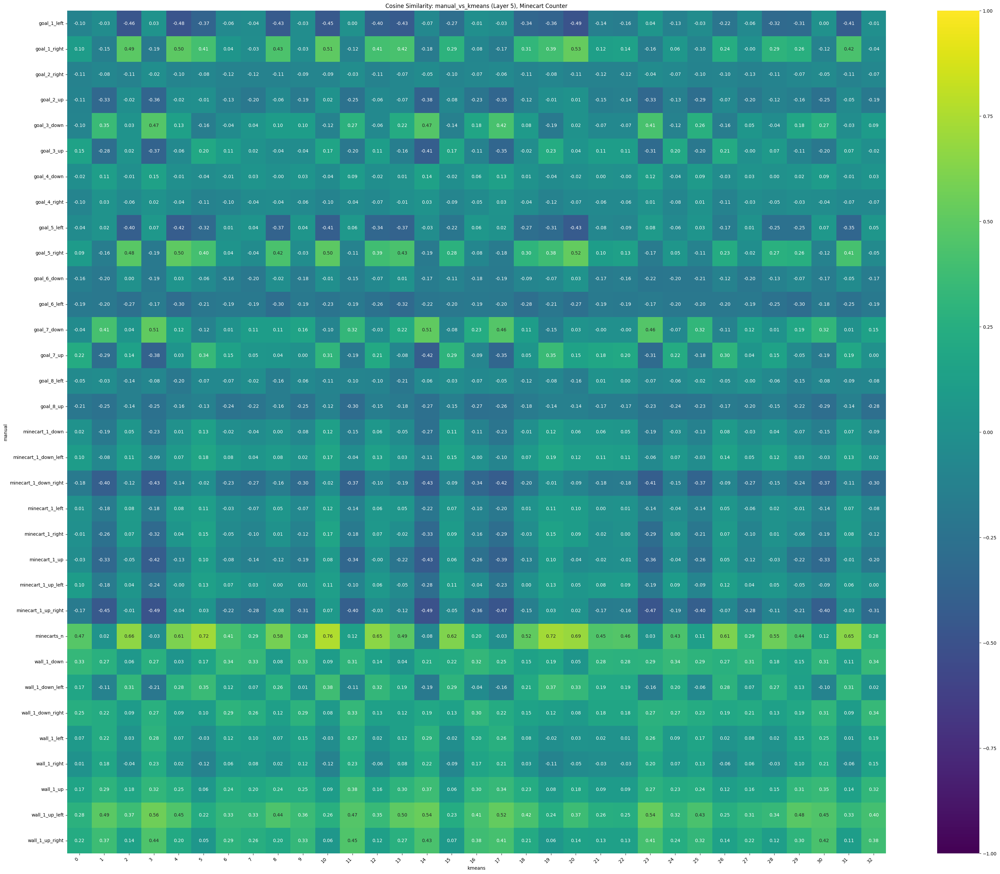

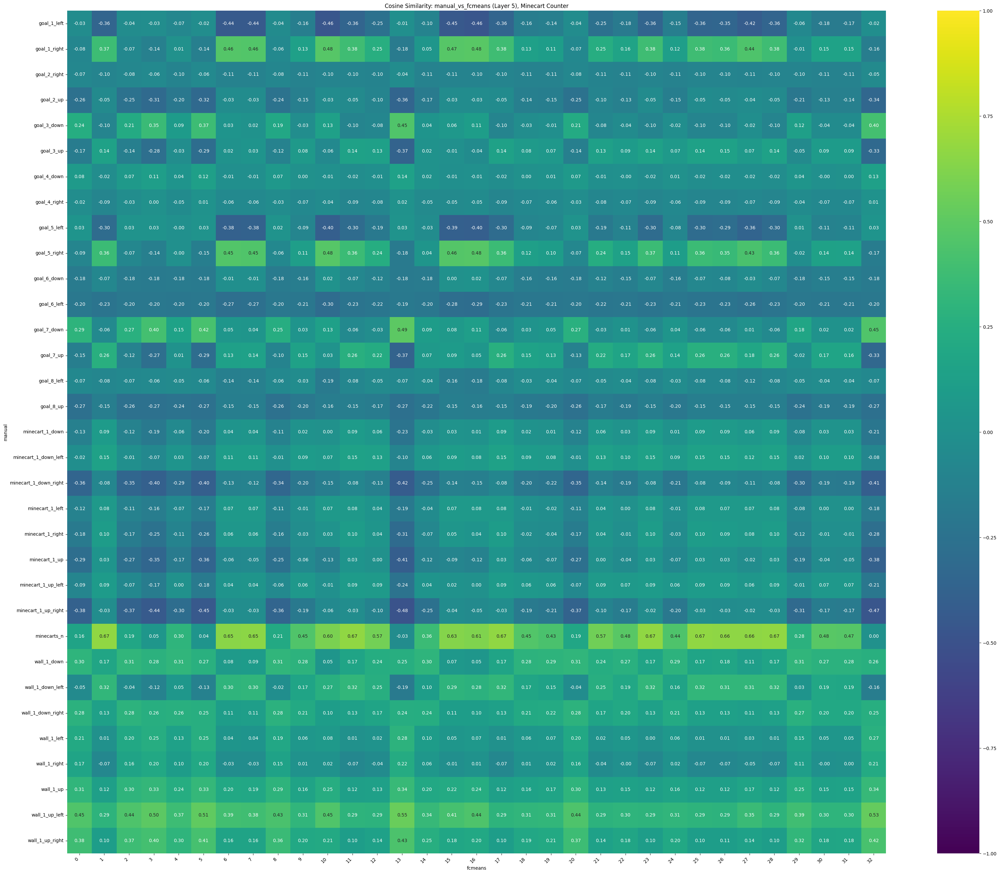

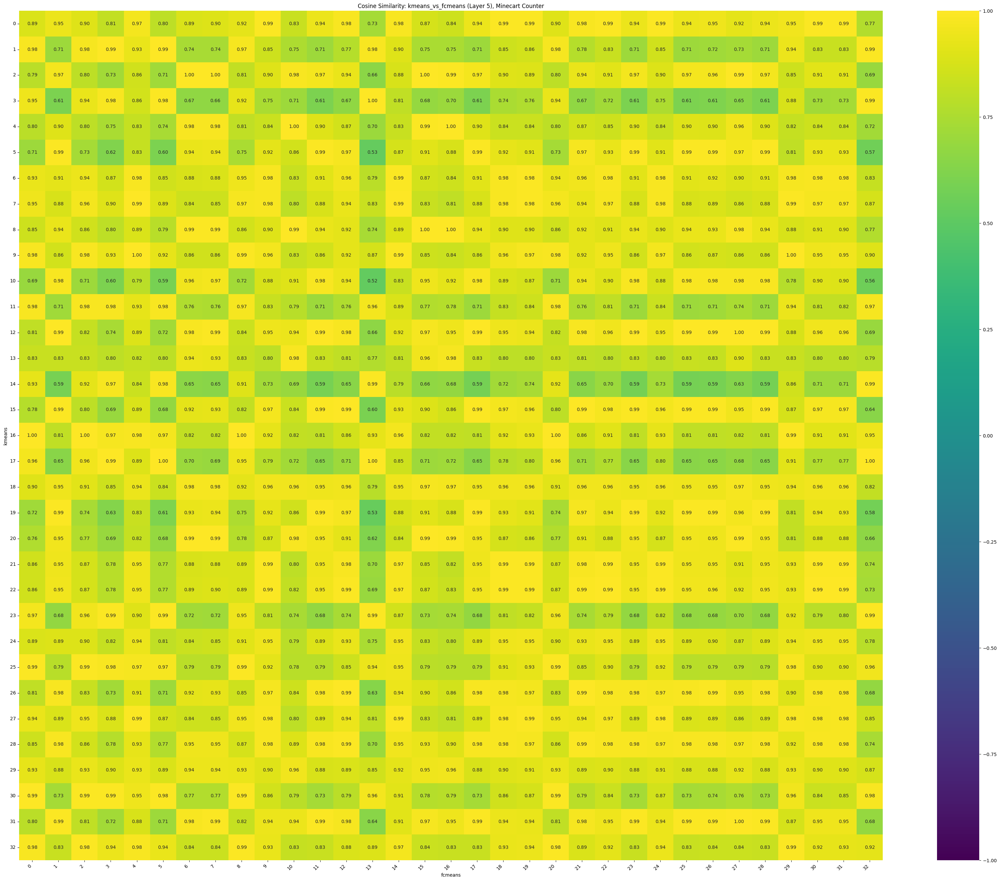

In [31]:
manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/minecart_counter/completeness_testing/kind-cosmos-35/"
                )

conv_spatial_shapes = {
    0: (15, 15, 32),
    1: (15, 15, 64)
}

show_cav_cosine_similarity_matrices(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="minecart_counter", environment_display_name="Minecart Counter")

In [94]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_cav_similarities_to_manual_cavs(df_summary, env_name):
    summary = df_summary.groupby(["method", "cavs_n"])["total_cosine_similarity"].agg(["mean", "min", "max"]).reset_index()

    plt.figure(figsize=(10, 6))

    for method in summary["method"].unique():
        sub = summary[summary["method"] == method]
        plt.plot(sub["cavs_n"], sub["mean"], label=method)
        plt.fill_between(sub["cavs_n"], sub["min"], sub["max"], alpha=0.2)

    plt.title(f"Total Cosine Similarity with Manual Concepts, Best Matching CAVs, {env_name}")
    plt.xlabel("Number of Discovered CAVs")
    plt.ylabel("Total Cosine Similarity")
    plt.legend()
    plt.tight_layout()
    plt.show()

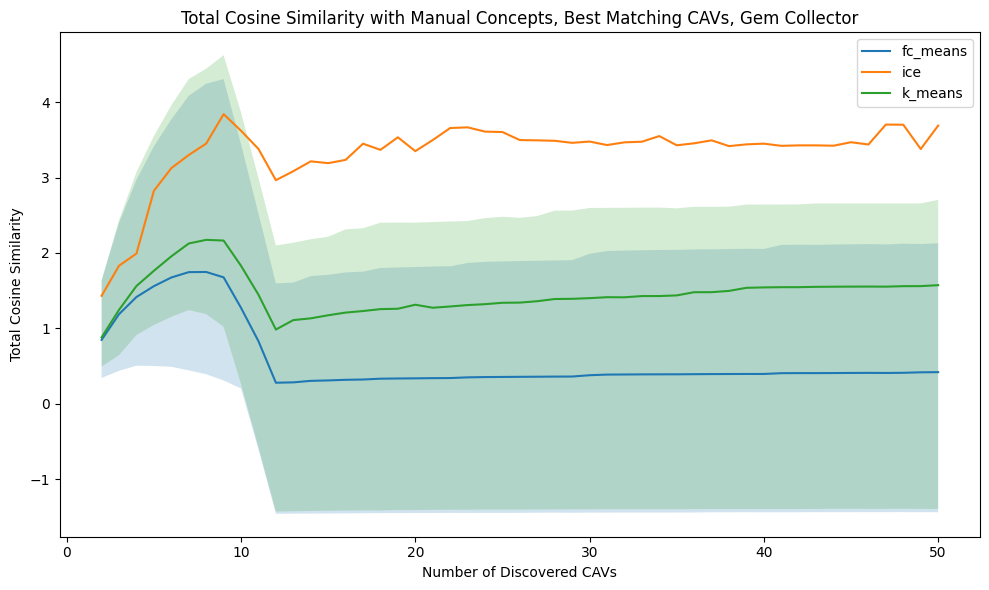

In [99]:
manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/gem_collector/completeness_testing/denim-sweep-56/"
                )

conv_spatial_shapes = {
    0: (20, 20, 32),
    1: (20, 20, 64)
}

df_matches, df_summary = match_cavs_to_manual_cavs(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="gem_collector")

plot_cav_similarities_to_manual_cavs(df_summary, "Gem Collector")

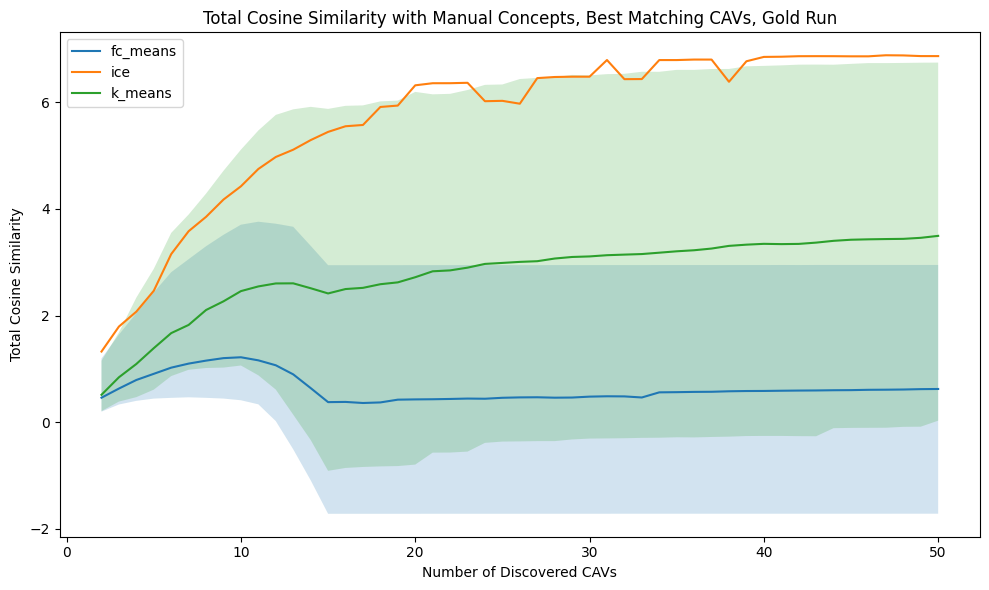

In [100]:
manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/gold_run_mini/completeness_testing/firm-mountain-13/"
                )

conv_spatial_shapes = {
    0: (11, 11, 32),
    1: (11, 11, 64)
}

df_matches, df_summary = match_cavs_to_manual_cavs(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="gold_run_mini")

plot_cav_similarities_to_manual_cavs(df_summary, "Gold Run")

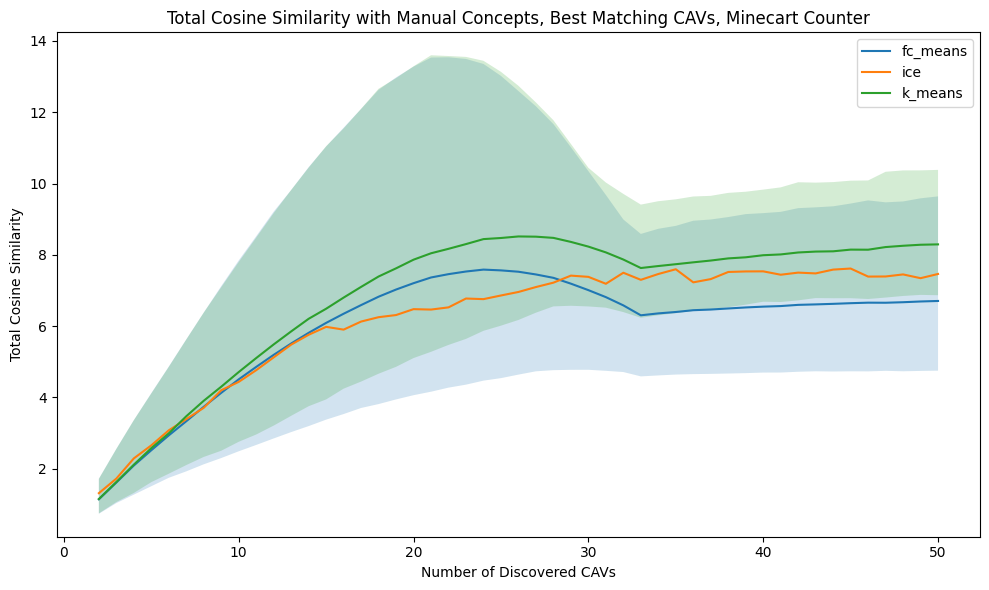

In [101]:
manual_concept_probe_path = (
                    "../../rl_tcav_data/concept_probes/minecart_counter/completeness_testing/kind-cosmos-35/"
                )

conv_spatial_shapes = {
    0: (15, 15, 32),
    1: (15, 15, 64)
}

df_matches, df_summary = match_cavs_to_manual_cavs(manual_concept_probe_path=manual_concept_probe_path, conv_spatial_shapes=conv_spatial_shapes, environment_name="minecart_counter")

plot_cav_similarities_to_manual_cavs(df_summary, "Minecart Counter")

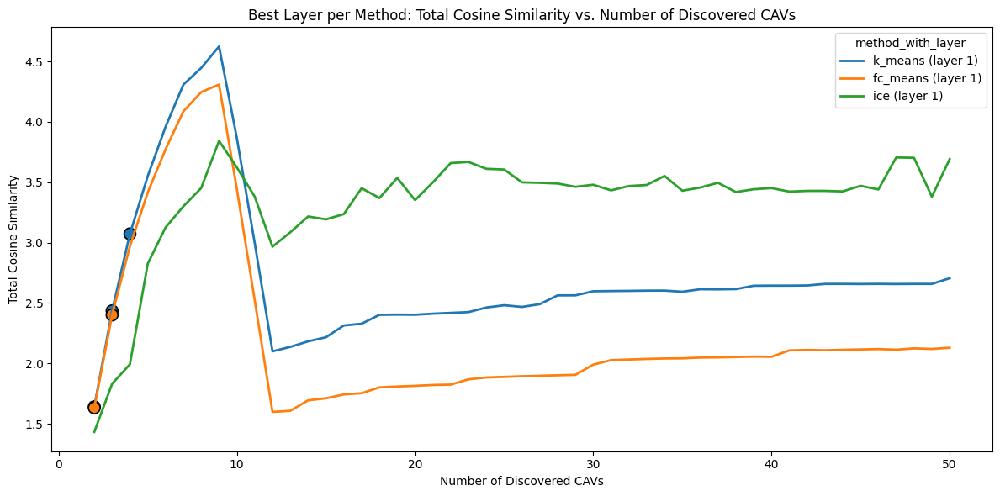

In [ ]:
""" import seaborn as sns
import matplotlib.pyplot as plt

# Define a consistent palette
base_palette = {
    "k_means": "#1f77b4",
    "fc_means": "#ff7f0e",
    "ice": "#2ca02c",
}

# Step 1: Create best_df with method+layer label
best_layer_rows = []

for method in df_summary["method"].unique():
    method_df = df_summary[df_summary["method"] == method]
    
    # Find the best-performing layer for this method
    best_layer = (
        method_df.groupby("layer")["total_cosine_similarity"]
        .max()
        .idxmax()
    )

    # Filter to that layer
    best_rows = method_df[method_df["layer"] == best_layer].copy()
    
    # Add a descriptive label
    best_rows["method_with_layer"] = f"{method} (layer {best_layer})"

    best_layer_rows.append(best_rows)

# Concatenate
best_df = pd.concat(best_layer_rows)

# Add mask for strong matches
best_df["strong_match"] = best_df["total_cosine_similarity"] >= 0.75 * best_df["cavs_n"]

# Assign palette using new labels
methods_with_layers = best_df["method_with_layer"].unique()
palette = {label: base_palette[label.split()[0]] for label in methods_with_layers}

# Plot
plt.figure(figsize=(12, 6))
sns.lineplot(
    data=best_df,
    x="cavs_n",
    y="total_cosine_similarity",
    hue="method_with_layer",
    palette=palette,
    linewidth=2,
)

# Scatter for strong matches
highlight_df = best_df[best_df["strong_match"]]
sns.scatterplot(
    data=highlight_df,
    x="cavs_n",
    y="total_cosine_similarity",
    hue="method_with_layer",
    palette=palette,
    legend=False,
    s=100,
    edgecolor="black",
    linewidth=1.2,
)

# Labels and layout
plt.title("Best Layer per Method: Total Cosine Similarity vs. Number of Discovered CAVs")
plt.xlabel("Number of Discovered CAVs")
plt.ylabel("Total Cosine Similarity")
plt.tight_layout()
plt.show() """